In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
pd.set_option('display.max_colwidth', None)

In [2]:
df_train = pd.read_csv('/Users/subikshc/Documents/Code/Springboard Course/Capstone 3/archive (14)/data/train.tsv',
                       sep ='\t',header = None, names = ['text','label','id'])

In [3]:
cd

/Users/subikshc


In [4]:
ls

Applications/   Downloads/      Music/          Untitled.ipynb
Desktop/        Library/        Pictures/       anaconda3/
Documents/      Movies/         Public/         nltk_data/


In [5]:
ls

Applications/   Downloads/      Music/          Untitled.ipynb
Desktop/        Library/        Pictures/       anaconda3/
Documents/      Movies/         Public/         nltk_data/


In [6]:
df_train

,text,label,id
0,My favourite food is anything I didn't have to cook myself.,27,eebbqej
1,"Now if he does off himself, everyone will think hes having a laugh screwing with people instead of actually dead",27,ed00q6i
2,WHY THE FUCK IS BAYLESS ISOING,2,eezlygj
3,To make her feel threatened,14,ed7ypvh
4,Dirty Southern Wankers,3,ed0bdzj
...,...,...,...
43405,Added you mate well I’ve just got the bow and I love the hunting aspect of the game so happily join you hunting and what not,18,edsb738
43406,Always thought that was funny but is it a reference to anything?,6,ee7fdou
43407,What are you talking about? Anything bad that happened was [NAME] fault - only good things were [NAME] doing!,3,efgbhks
43408,"More like a baptism, with sexy results!",13,ed1naf8


In [7]:
df_train.label.info()

<class 'pandas.core.series.Series'>
RangeIndex: 43410 entries, 0 to 43409
Series name: label
Non-Null Count  Dtype 
--------------  ----- 
43410 non-null  object
dtypes: object(1)
memory usage: 339.3+ KB


In [8]:
df_train['labels_list'] = df_train['label'].apply(lambda x: x.split(','))
df_train['labels_len'] = df_train['labels_list'].apply(lambda x: len(x))

In [9]:
df_train['labels_len'].describe()

count    43410.000000
mean         1.177217
std          0.417699
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max          5.000000
Name: labels_len, dtype: float64

In [10]:
df_train

,text,label,id,labels_list,labels_len
0,My favourite food is anything I didn't have to cook myself.,27,eebbqej,[27],1
1,"Now if he does off himself, everyone will think hes having a laugh screwing with people instead of actually dead",27,ed00q6i,[27],1
2,WHY THE FUCK IS BAYLESS ISOING,2,eezlygj,[2],1
3,To make her feel threatened,14,ed7ypvh,[14],1
4,Dirty Southern Wankers,3,ed0bdzj,[3],1
...,...,...,...,...,...
43405,Added you mate well I’ve just got the bow and I love the hunting aspect of the game so happily join you hunting and what not,18,edsb738,[18],1
43406,Always thought that was funny but is it a reference to anything?,6,ee7fdou,[6],1
43407,What are you talking about? Anything bad that happened was [NAME] fault - only good things were [NAME] doing!,3,efgbhks,[3],1
43408,"More like a baptism, with sexy results!",13,ed1naf8,[13],1


In [11]:
df_train.isnull().sum()

text           0
label          0
id             0
labels_list    0
labels_len     0
dtype: int64

In [12]:
df_train.labels_list.value_counts()

[27]              12823
[0]                2710
[4]                1873
[15]               1857
[1]                1652
                  ...  
[6, 15, 22]           1
[9, 10, 19]           1
[7, 10, 25]           1
[7, 9, 24, 25]        1
[0, 1, 18]            1
Name: labels_list, Length: 711, dtype: int64

<Axes: >

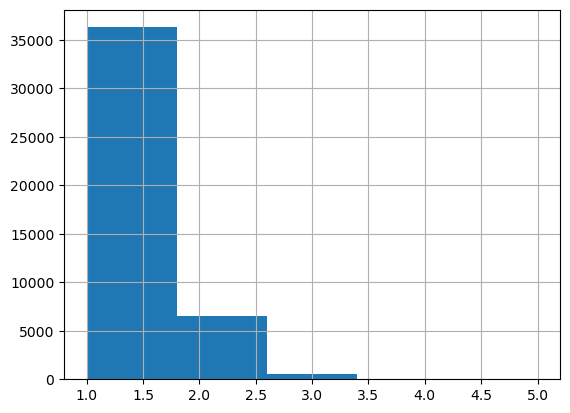

In [13]:
df_train.labels_len.hist(bins = 5)

In [14]:
df_train.labels_len.value_counts(normalize = True)

1    0.836397
2    0.150680
3    0.012255
4    0.000645
5    0.000023
Name: labels_len, dtype: float64

In [15]:
df_train[df_train.labels_len == 2].labels_list.value_counts()[0:10]

[2, 3]      230
[0, 15]     227
[0, 4]      199
[4, 27]     190
[6, 7]      174
[0, 18]     155
[3, 10]     148
[3, 27]     123
[10, 27]    104
[9, 25]     103
Name: labels_list, dtype: int64

In [16]:
emotions = {
0:'admiration',
1:'amusement',
2:'anger',
3:'annoyance',
4:'approval',
5:'caring',
6:'confusion',
7:'curiosity',
8:'desire',
9:'disappointment',
10:'disapproval',
11:'disgust',
12:'embarrassment',
13:'excitement',
14:'fear',
15:'gratitude',
16:'grief',
17:'joy',
18:'love',
19:'nervousness',
20:'optimism',
21:'pride',
22:'realization',
23:'relief',
24:'remorse',
25:'sadness',
26:'surprise',
27:'neutral'}
emotions

{0: 'admiration',
 1: 'amusement',
 2: 'anger',
 3: 'annoyance',
 4: 'approval',
 5: 'caring',
 6: 'confusion',
 7: 'curiosity',
 8: 'desire',
 9: 'disappointment',
 10: 'disapproval',
 11: 'disgust',
 12: 'embarrassment',
 13: 'excitement',
 14: 'fear',
 15: 'gratitude',
 16: 'grief',
 17: 'joy',
 18: 'love',
 19: 'nervousness',
 20: 'optimism',
 21: 'pride',
 22: 'realization',
 23: 'relief',
 24: 'remorse',
 25: 'sadness',
 26: 'surprise',
 27: 'neutral'}

In [17]:
def id2emotions(lst):
    emotions_lst = []
    for i in lst:
        emotions_lst.append(emotions[int(i)])
    return emotions_lst

In [18]:
df_train['emotions_list'] = df_train['labels_list'].apply(id2emotions)

In [19]:
df_train['labels_list'] = df_train['labels_list'].apply(lambda lst: list(map(int, lst)))

In [20]:
for i in emotions:
    df_train[emotions[i]] = df_train['labels_list'].apply(lambda x: 1 if i in x else 0)

In [21]:
df_train['emotions_list'].value_counts()

[neutral]                                        12823
[admiration]                                      2710
[approval]                                        1873
[gratitude]                                       1857
[amusement]                                       1652
                                                 ...  
[confusion, gratitude, realization]                  1
[disappointment, disapproval, nervousness]           1
[curiosity, disapproval, sadness]                    1
[curiosity, disappointment, remorse, sadness]        1
[admiration, amusement, love]                        1
Name: emotions_list, Length: 711, dtype: int64

In [22]:
type(df_train.iloc[0]['labels_list'][0])

int

In [23]:
df_train

,text,label,id,labels_list,labels_len,emotions_list,admiration,amusement,anger,annoyance,...,love,nervousness,optimism,pride,realization,relief,remorse,sadness,surprise,neutral
0,My favourite food is anything I didn't have to cook myself.,27,eebbqej,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
1,"Now if he does off himself, everyone will think hes having a laugh screwing with people instead of actually dead",27,ed00q6i,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,WHY THE FUCK IS BAYLESS ISOING,2,eezlygj,[2],1,[anger],0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,To make her feel threatened,14,ed7ypvh,[14],1,[fear],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Dirty Southern Wankers,3,ed0bdzj,[3],1,[annoyance],0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43405,Added you mate well I’ve just got the bow and I love the hunting aspect of the game so happily join you hunting and what not,18,edsb738,[18],1,[love],0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
43406,Always thought that was funny but is it a reference to anything?,6,ee7fdou,[6],1,[confusion],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
43407,What are you talking about? Anything bad that happened was [NAME] fault - only good things were [NAME] doing!,3,efgbhks,[3],1,[annoyance],0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
43408,"More like a baptism, with sexy results!",13,ed1naf8,[13],1,[excitement],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [24]:
contraction_mapping = {"ain't": "is not", "aren't": "are not","can't": "cannot", "'cause": "because", "could've": "could have", "couldn't": "could not", 
                       "didn't": "did not",  "doesn't": "does not", "don't": "do not", "hadn't": "had not", "hasn't": "has not", "haven't": "have not", 
                       "he'd": "he would","he'll": "he will", "he's": "he is", "how'd": "how did", "how'd'y": "how do you", "how'll": "how will", 
                       "how's": "how is",  "I'd": "I would", "I'd've": "I would have", "I'll": "I will", "I'll've": "I will have","I'm": "I am",
                       "I've": "I have", "i'd": "i would", "i'd've": "i would have", "i'll": "i will",  "i'll've": "i will have","i'm": "i am", 
                       "i've": "i have", "isn't": "is not", "it'd": "it would", "it'd've": "it would have", "it'll": "it will", "it'll've": "it will have",
                       "it's": "it is", "let's": "let us", "ma'am": "madam", "mayn't": "may not", "might've": "might have","mightn't": "might not",
                       "mightn't've": "might not have", "must've": "must have", "mustn't": "must not", "mustn't've": "must not have", "needn't": "need not", 
                       "needn't've": "need not have","o'clock": "of the clock", "oughtn't": "ought not", "oughtn't've": "ought not have", "shan't": "shall not",
                       "sha'n't": "shall not", "shan't've": "shall not have", "she'd": "she would", "she'd've": "she would have", "she'll": "she will", 
                       "she'll've": "she will have", "she's": "she is", "should've": "should have", "shouldn't": "should not", "shouldn't've": "should not have",
                       "so've": "so have","so's": "so as", "this's": "this is","that'd": "that would", "that'd've": "that would have", "that's": "that is",
                       "there'd": "there would", "there'd've": "there would have", "there's": "there is", "here's": "here is","they'd": "they would",
                       "they'd've": "they would have", "they'll": "they will", "they'll've": "they will have", "they're": "they are", "they've": "they have",
                       "to've": "to have", "wasn't": "was not", "we'd": "we would", "we'd've": "we would have", "we'll": "we will", "we'll've": "we will have",
                       "we're": "we are", "we've": "we have", "weren't": "were not", "what'll": "what will", "what'll've": "what will have", 
                       "what're": "what are",  "what's": "what is", "what've": "what have", "when's": "when is", "when've": "when have", "where'd": "where did",
                       "where's": "where is", "where've": "where have", "who'll": "who will", "who'll've": "who will have", "who's": "who is", 
                       "who've": "who have", "why's": "why is", "why've": "why have", "will've": "will have", "won't": "will not", "won't've": "will not have", 
                       "would've": "would have", "wouldn't": "would not", "wouldn't've": "would not have", "y'all": "you all", "y'all'd": "you all would",
                       "y'all'd've": "you all would have","y'all're": "you all are","y'all've": "you all have","you'd": "you would", "you'd've": "you would have",
                       "you'll": "you will", "you'll've": "you will have", "you're": "you are", "you've": "you have", 'u.s':'america', 'e.g':'for example'}



In [25]:
punct = [',', '.', '"', ':', ')', '(', '-', '!', '?', '|', ';', "'", '$', '&', '/', '[', ']', '>', '%', '=', '#', '*', '+', '\\', '•',  '~', '@', '£', 
 '·', '_', '{', '}', '©', '^', '®', '`',  '<', '→', '°', '€', '™', '›',  '♥', '←', '×', '§', '″', '′', 'Â', '█', '½', 'à', '…', 
 '“', '★', '”', '–', '●', 'â', '►', '−', '¢', '²', '¬', '░', '¶', '↑', '±', '¿', '▾', '═', '¦', '║', '―', '¥', '▓', '—', '‹', '─', 
 '▒', '：', '¼', '⊕', '▼', '▪', '†', '■', '’', '▀', '¨', '▄', '♫', '☆', 'é', '¯', '♦', '¤', '▲', 'è', '¸', '¾', 'Ã', '⋅', '‘', '∞', 
 '∙', '）', '↓', '、', '│', '（', '»', '，', '♪', '╩', '╚', '³', '・', '╦', '╣', '╔', '╗', '▬', '❤', 'ï', 'Ø', '¹', '≤', '‡', '√', ]

punct_mapping = {"‘": "'", "₹": "e", "´": "'", "°": "", "€": "e", "™": "tm", "√": " sqrt ", "×": "x", "²": "2", "—": "-", "–": "-", "’": "'", "_": "-",
                 "`": "'", '“': '"', '”': '"', '“': '"', "£": "e", '∞': 'infinity', 'θ': 'theta', '÷': '/', 'α': 'alpha', '•': '.', 'à': 'a', '−': '-', 
                 'β': 'beta', '∅': '', '³': '3', 'π': 'pi', '!':' '}

mispell_dict = {'colour': 'color', 'centre': 'center', 'favourite': 'favorite', 'travelling': 'traveling', 'counselling': 'counseling', 'theatre': 'theater',
                'cancelled': 'canceled', 'labour': 'labor', 'organisation': 'organization', 'wwii': 'world war 2', 'citicise': 'criticize', 'youtu ': 'youtube ',
                'Qoura': 'Quora', 'sallary': 'salary', 'Whta': 'What', 'narcisist': 'narcissist', 'howdo': 'how do', 'whatare': 'what are', 'howcan': 'how can',
                'howmuch': 'how much', 'howmany': 'how many', 'whydo': 'why do', 'doI': 'do I', 'theBest': 'the best', 'howdoes': 'how does', 
                'mastrubation': 'masturbation', 'mastrubate': 'masturbate', "mastrubating": 'masturbating', 'pennis': 'penis', 'Etherium': 'Ethereum', 
                'narcissit': 'narcissist', 'bigdata': 'big data', '2k17': '2017', '2k18': '2018', 'qouta': 'quota', 'exboyfriend': 'ex boyfriend', 
                'airhostess': 'air hostess', "whst": 'what', 'watsapp': 'whatsapp', 'demonitisation': 'demonetization', 'demonitization': 'demonetization',
                'demonetisation': 'demonetization'}

In [26]:
import spacy
import pandas as pd
import numpy as np
import nltk
nltk.download('wordnet')
from nltk.corpus import stopwords
from nltk.tokenize.toktok import ToktokTokenizer
import re
from bs4 import BeautifulSoup
from contractions import CONTRACTION_MAP
from nltk.stem import WordNetLemmatizer
import unicodedata
import en_core_web_sm
nlp = en_core_web_sm.load()
#nlp_vec = spacy.load('en_vecs', parse = True, tag=True, #entity=True)
tokenizer = ToktokTokenizer()
stopword_list = nltk.corpus.stopwords.words('english')
stopword_list.remove('no')
stopword_list.remove('not')

[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/subikshc/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [27]:
def remove_accented_chars(text):
    text = unicodedata.normalize('NFKD', text).encode('ascii', 'ignore').decode('utf-8', 'ignore')
    return text

remove_accented_chars('Sómě Áccěntěd těxt')

'Some Accented text'

In [28]:
def expand_contractions(text, contraction_mapping=CONTRACTION_MAP):
    
    contractions_pattern = re.compile('({})'.format('|'.join(contraction_mapping.keys())), 
                                      flags=re.IGNORECASE|re.DOTALL)
    def expand_match(contraction):
        match = contraction.group(0)
        first_char = match[0]
        expanded_contraction = contraction_mapping.get(match)\
                                if contraction_mapping.get(match)\
                                else contraction_mapping.get(match.lower())                       
        expanded_contraction = first_char+expanded_contraction[1:]
        return expanded_contraction
        
    expanded_text = contractions_pattern.sub(expand_match, text)
    expanded_text = re.sub("'", "", expanded_text)
    return expanded_text

expand_contractions("Y'all can't expand contractions I'd think")

'You all cannot expand contractions I would think'

In [29]:
def remove_special_characters(text, remove_digits=False):
    pattern = r'[^a-zA-z0-9\s]' if not remove_digits else r'[^a-zA-z\s]'
    text = re.sub(pattern, '', text)
    return text

remove_special_characters("Well this was fun! What do you think? 123#@!", 
                          remove_digits=True)

'Well this was fun What do you think '

In [30]:
def lemmatize_text(text):
    text = nlp(text)
    text = ' '.join([word.lemma_ if word.lemma_ != '-PRON-' else word.text for word in text])
    return text

lemmatize_text("My system keeps crashing! his crashed yesterday, ours crashes daily")

'my system keep crash ! his crashed yesterday , ours crash daily'

In [31]:
def remove_stopwords(text, is_lower_case=False):
    tokens = tokenizer.tokenize(text)
    tokens = [token.strip() for token in tokens]
    if is_lower_case:
        filtered_tokens = [token for token in tokens if token not in stopword_list]
    else:
        filtered_tokens = [token for token in tokens if token.lower() not in stopword_list]
    filtered_text = ' '.join(filtered_tokens)    
    return filtered_text

remove_stopwords("The, and, if are stopwords, computer is not")

', , stopwords , computer not'

In [32]:
lm = WordNetLemmatizer()

In [33]:
def text_processor(col):
    corpus = []
    for item in col:
        new_item = re.sub('[^a-zA-Z]',' ',str(item))
        new_item = remove_accented_chars(new_item)
        new_item = expand_contractions(new_item)
        new_item = remove_special_characters(new_item)
        new_item = new_item.lower()
        new_item = new_item.split()
        new_item = [lm.lemmatize(word) for word in new_item if word not in set(stopword_list)]
        corpus.append(' '.join(str(x) for x in new_item))
    return corpus

In [34]:
texts = ['this is a preetty cool test sentience','Do you SEE THESE IN CAPS??',"we can't all do this ain't it great"]
text_processor(texts)

['preetty cool test sentience', 'see cap', 'great']

In [35]:
corpus = text_processor(df_train['text'])

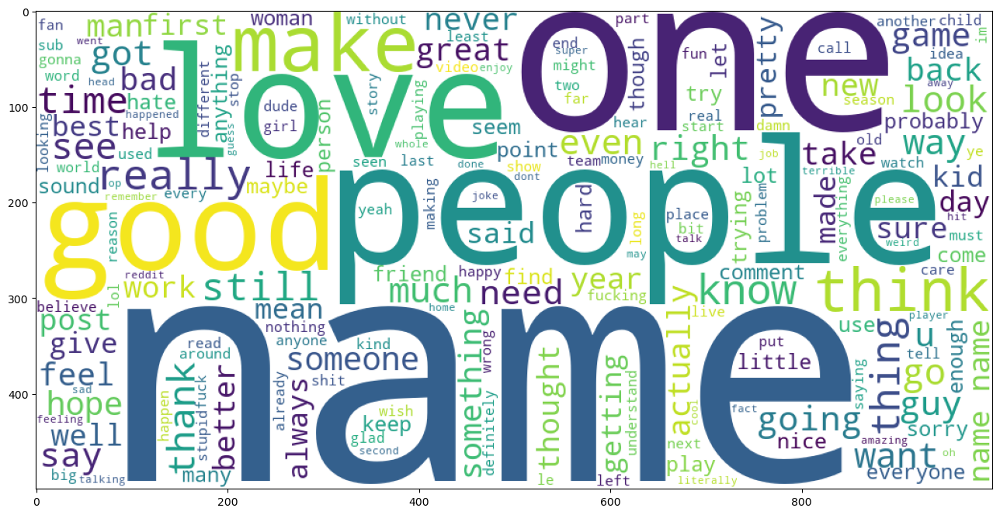

In [36]:
from wordcloud import WordCloud

plt.figure(figsize = (20,8))
word_cloud = ""
for row in corpus:
    for word in row:
        word_cloud+=" ".join(word)
wordcloud = WordCloud(width = 1000, height = 500,background_color ='white',min_font_size = 10).generate(word_cloud)
plt.imshow(wordcloud)

In [37]:
stopword_list.append('name')

In [38]:
df_train['clean_text'] =  text_processor(df_train['text'])

In [39]:
df_single_emotion = df_train[df_train['labels_len'] == 1]

In [40]:
df_train['clean_text'] = df_train['clean_text'].astype(str)

In [41]:
emotions_text = {}
for e in emotions:
    emotion = emotions.get(e)
    
    emotions_text[emotion] = df_single_emotion[df_single_emotion[emotion] > 0]['clean_text'].sum()
    
    

In [42]:
emotion = emotions.get(2)
df_single_emotion[df_single_emotion[emotion] > 0]['clean_text'].sum()

'fuck bayless isoingfucking cowardstupidly stubborn stubbornly stupidtroll bro know saying stupid shit motherfucker nothing stink libertarian sub talking shitfuck mogespecially australia gonna cop ad tv god hatekill scumtold pointless point idiotfuck backgroundfucking please nosupporter dumbest human fucking galaxy locked safetyok know suck scrubforce someone come know look killed bastardya hate talk bad get stick butt make smarter decision communitycomment like biggest reason get pissed fucking centrist cry side argumentfuck atheist countryjob job know hardware store make ppl stupid hell stupidmajority move stupidly long name go angel punisher dive bomb radiance finish job punishing light bladesaid hated dont give damn either wayfucking starvingeat fuckfire medical teamugh sound like slob leavekilling timefucking boyfuck white house fuck mcdonald fuck postbitch yesexceedingly rare failure read article guy stupid stoppedhell talkingranting aimlessly internet obviouslyive seen move no l

In [43]:
emotions_text['anger']

'fuck bayless isoingfucking cowardstupidly stubborn stubbornly stupidtroll bro know saying stupid shit motherfucker nothing stink libertarian sub talking shitfuck mogespecially australia gonna cop ad tv god hatekill scumtold pointless point idiotfuck backgroundfucking please nosupporter dumbest human fucking galaxy locked safetyok know suck scrubforce someone come know look killed bastardya hate talk bad get stick butt make smarter decision communitycomment like biggest reason get pissed fucking centrist cry side argumentfuck atheist countryjob job know hardware store make ppl stupid hell stupidmajority move stupidly long name go angel punisher dive bomb radiance finish job punishing light bladesaid hated dont give damn either wayfucking starvingeat fuckfire medical teamugh sound like slob leavekilling timefucking boyfuck white house fuck mcdonald fuck postbitch yesexceedingly rare failure read article guy stupid stoppedhell talkingranting aimlessly internet obviouslyive seen move no l

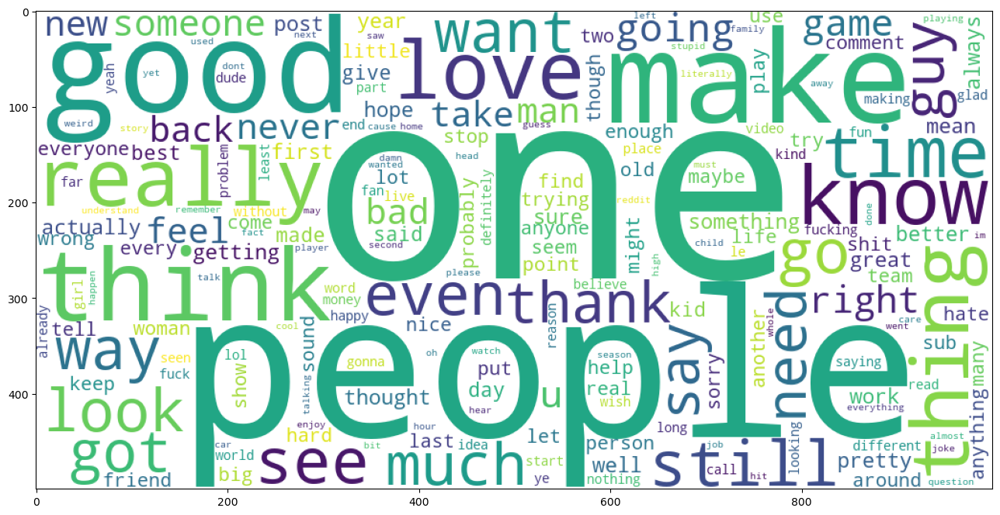

In [44]:
from wordcloud import WordCloud

plt.figure(figsize = (20,8))
word_cloud = ""
for e in emotions_text:
    for word in emotions_text[e]:
        word_cloud+=" ".join(word)
wordcloud = WordCloud(width = 1000, height = 500,background_color ='white',min_font_size = 10).generate(word_cloud)
plt.imshow(wordcloud)

In [45]:
def wordcloud_maker(name,lst):
    
    plt.figure(figsize = (20,8))
    word_cloud = ""
    
    for word in lst:
        word_cloud+=" ".join(word)
    wordcloud = WordCloud(width = 1000, height = 500,background_color ='white',min_font_size = 10).generate(word_cloud)
    plt.title(f"Wordcloud for {name}")
    plt.imshow(wordcloud)


In [46]:
emotions_text['admiration']

'damn youtube outrage drama super lucrative redditfamous defensetwilight still better love story last jediwonderful worldmake sound awesomeappreciate deadpan humourone good thing seasonstylist fit handsome guy big sexy hand say like tousles hairresponse truly one amazing one seenunderstand people give gold crossposts deserve upvotessuccess best revenge good job op stay strong almostsimple blunt people neednice photo city hallno idea fuck found ad watched actually decentsound nice owooh yeah great u era g k forgotgood news shark tale not finding nemogood deservesbrilliantgod damn fight backwell good opera often beautiful though retains stink upper class cant help deride art caters high society stay alivetook picture sunrise morning north austin pretty todaynice job building btwyeah highkey look decentsexy afone diverse place earthuncle awesomebrave soulbadass love see placed war pig amazing work optruly remarkable informative documentary well worth setting aside evening watchhey singapo

/var/folders/b6/_m6td1sj1gx6y7djysg9kvjr0000gn/T/ipykernel_48032/3111309442.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (20,8))


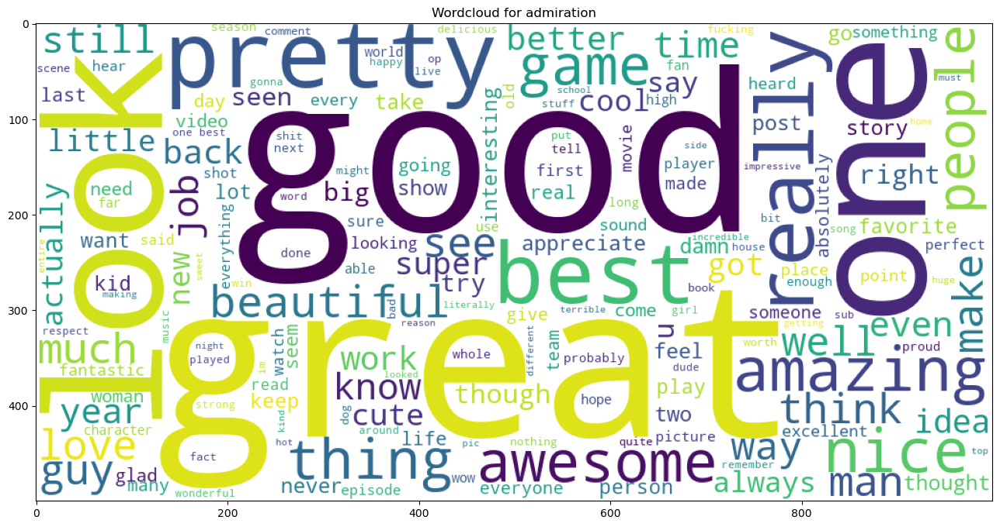

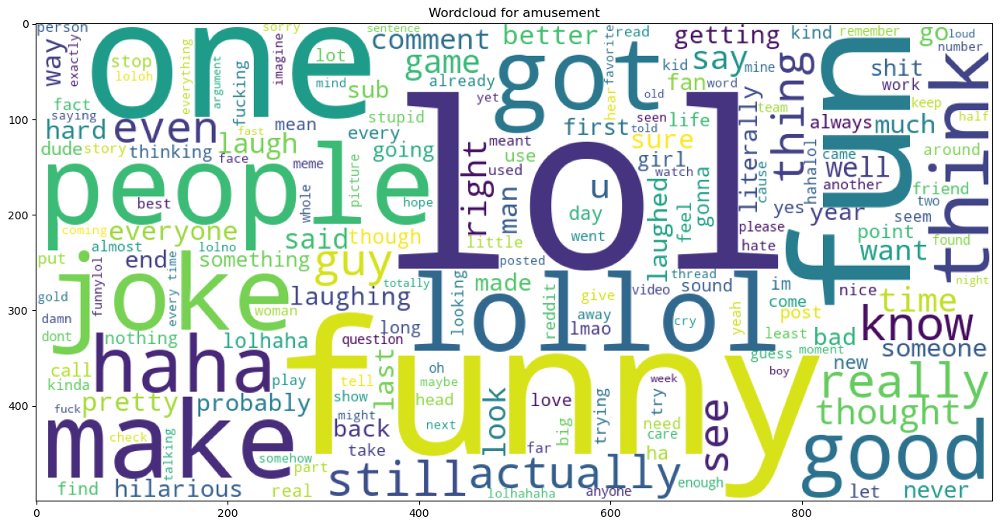

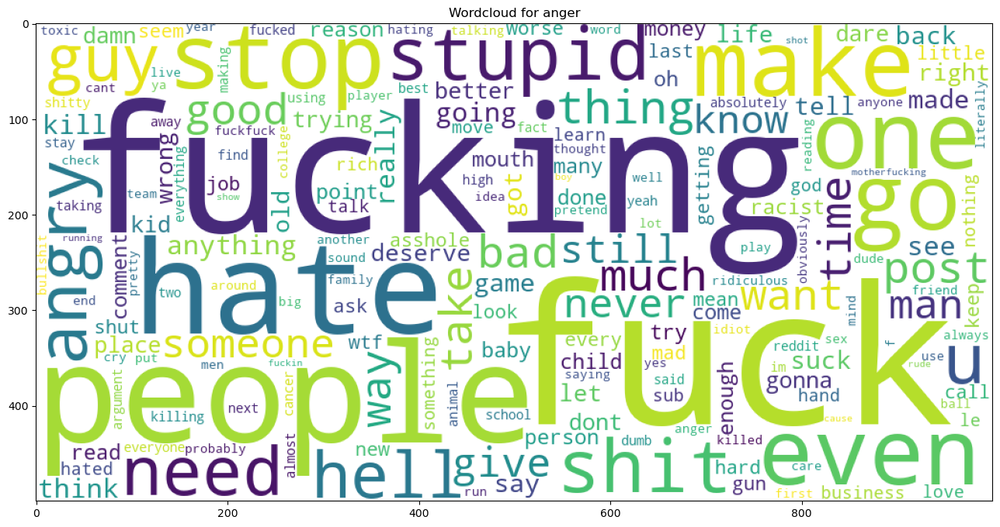

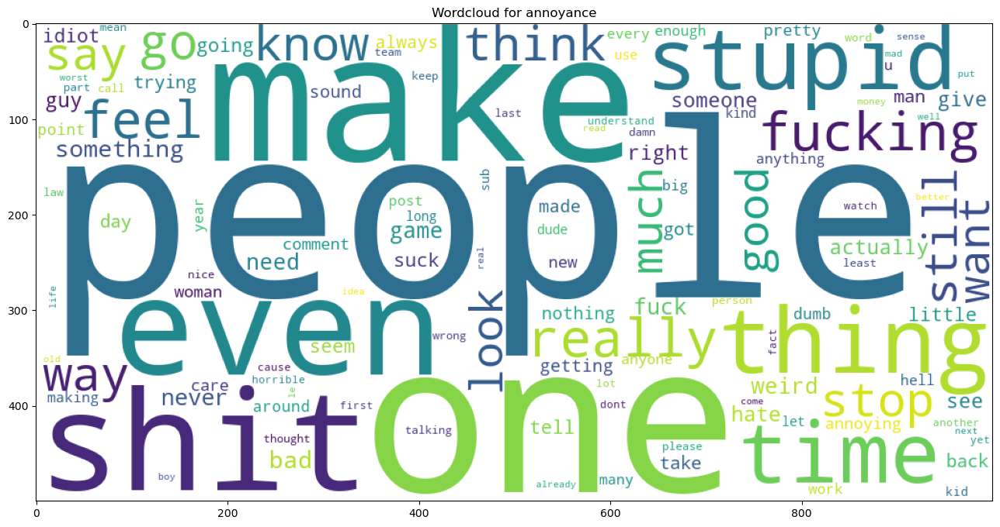

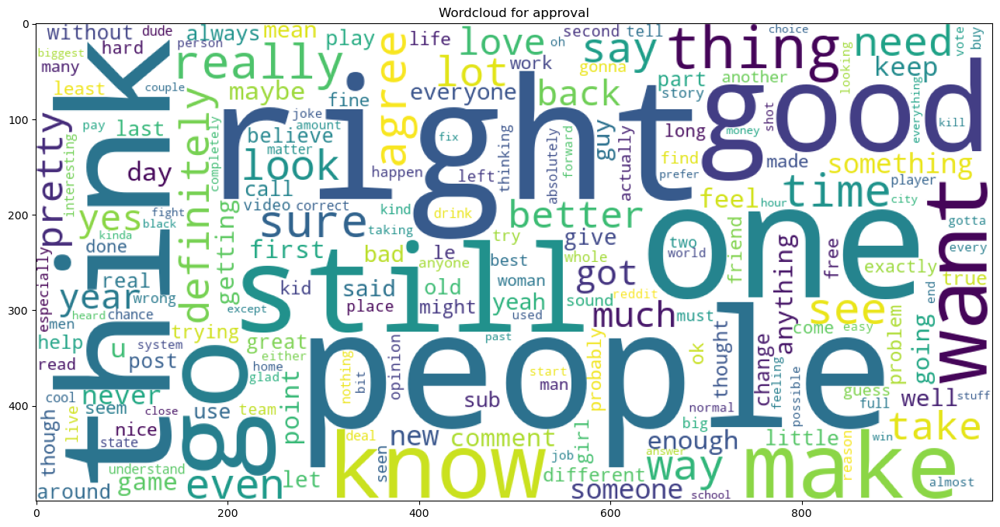

...

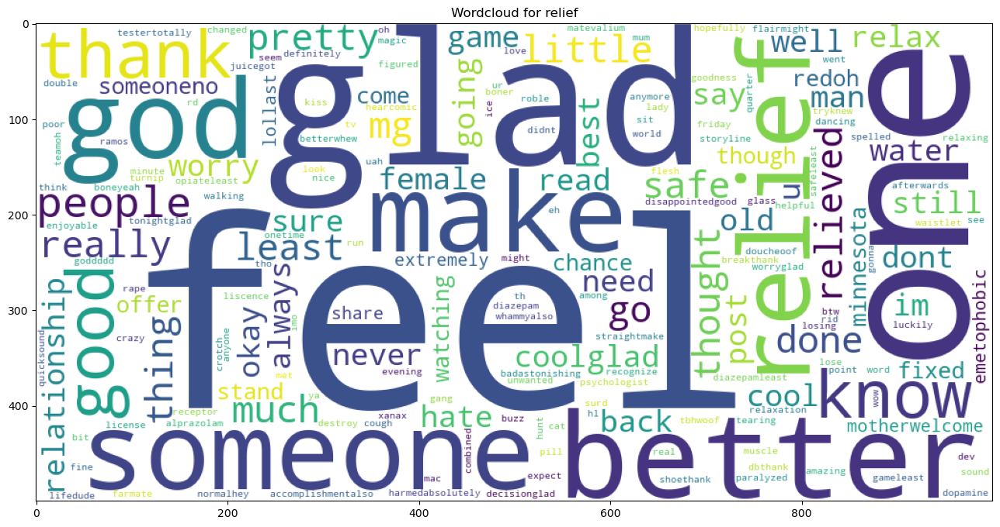

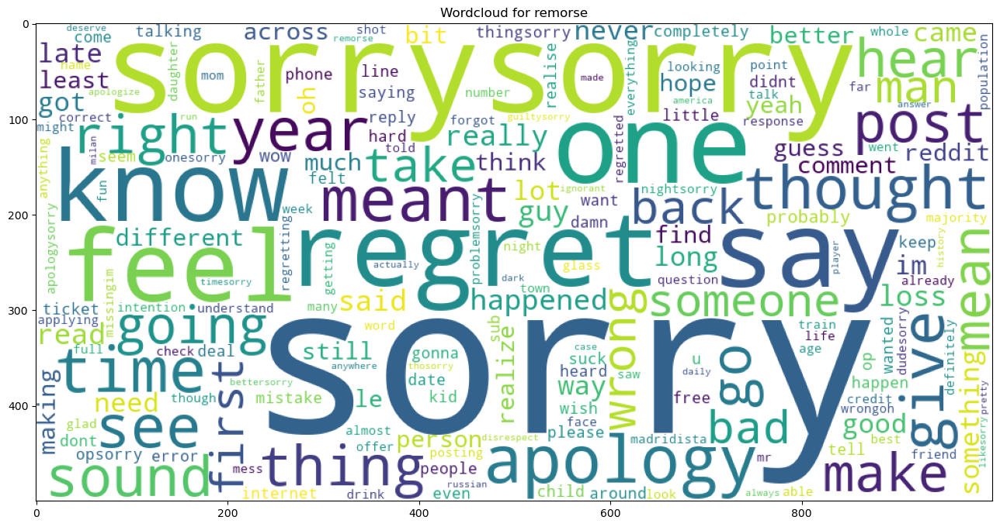

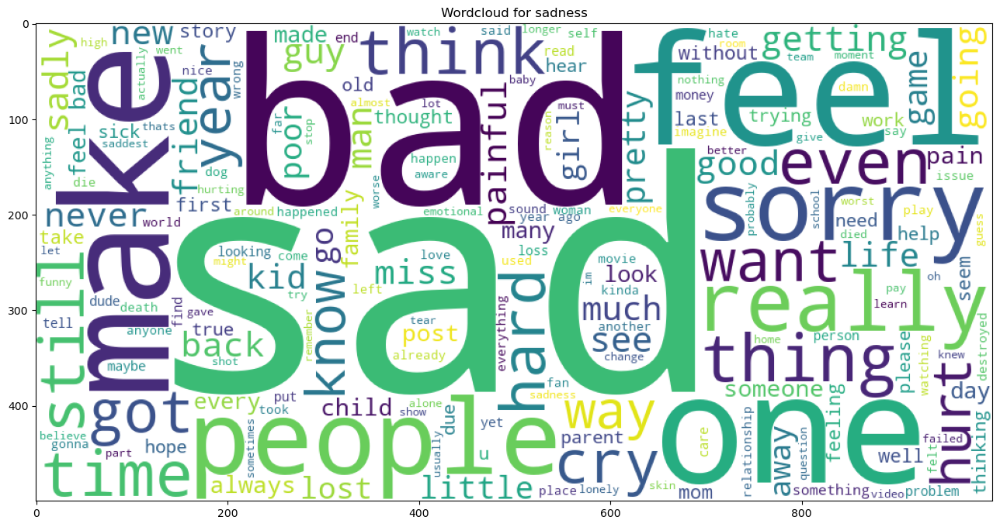

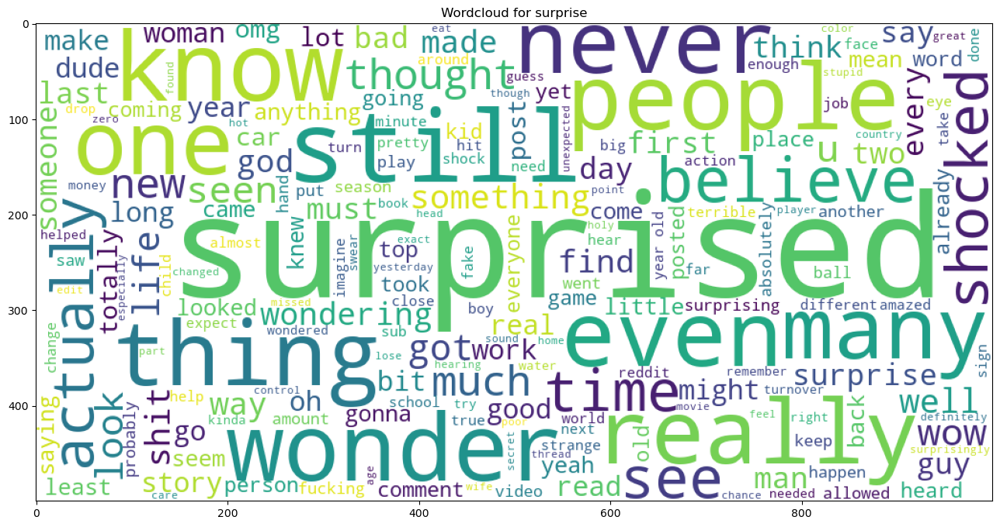

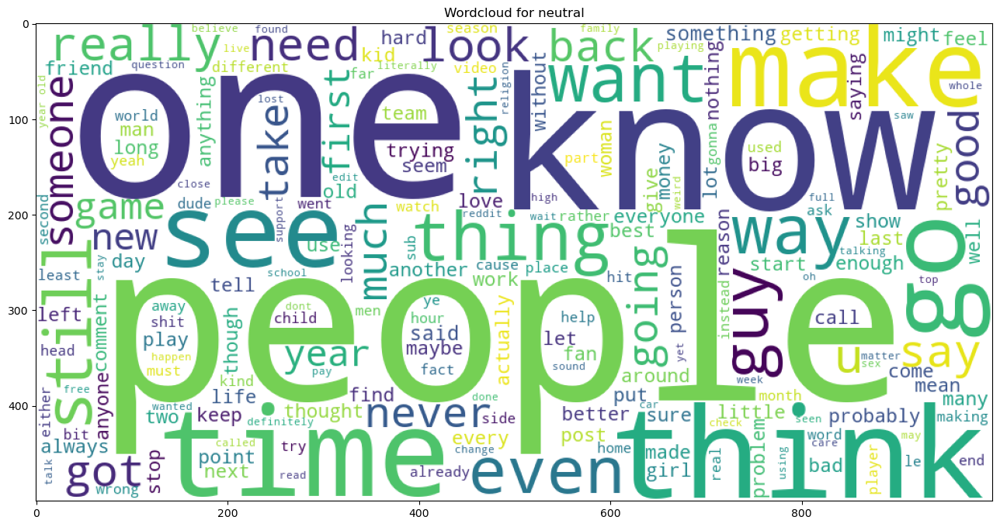

In [47]:
for e in emotions_text:
    wordcloud_maker(e,emotions_text[e])

In [48]:
df_train[df_train['clean_text'].str.contains('name')]

,text,label,id,labels_list,labels_len,emotions_list,admiration,amusement,anger,annoyance,...,nervousness,optimism,pride,realization,relief,remorse,sadness,surprise,neutral,clean_text
129,Tournament was a blast met some really cool people loved it all. Thanks for holding it. Would love to do it again someday,"0,8,15,17",edycw66,"[0, 8, 15, 17]",4,"[admiration, desire, gratitude, joy]",1,0,0,0,...,0,0,0,0,0,0,0,0,0,tournament blast met really cool people loved thanks holding would love someday
412,Change the initials to fake names. Was going to read but it’s too annoying.,"3,22",edut32r,"[3, 22]",2,"[annoyance, realization]",0,0,0,1,...,0,0,0,1,0,0,0,0,0,change initial fake name going read annoying
694,Because majority of moves have stupidly long names. GO INTO ANGEL PUNISHER INTO DIVE BOMB RADIANCE AND FINISH THE JOB WITH PUNISHING LIGHT BLADE,2,eetcmd6,[2],1,[anger],0,0,1,0,...,0,0,0,0,0,0,0,0,0,majority move stupidly long name go angel punisher dive bomb radiance finish job punishing light blade
1853,I love making peoples’ names verbs related to things they do!,18,eehxxis,[18],1,[love],0,0,0,0,...,0,0,0,0,0,0,0,0,0,love making people name verb related thing
2001,I love your username.,18,edlyvy1,[18],1,[love],0,0,0,0,...,0,0,0,0,0,0,0,0,0,love username
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42376,Oh I got you. Likewise for us. I’ll take a look later and name some names!,27,edd5aw9,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,1,oh got likewise u take look later name
42985,I sure as hell hope your username is a joke,1,effjx48,[1],1,[amusement],0,1,0,0,...,0,0,0,0,0,0,0,0,0,sure hell hope username joke
43004,Have a look at the decks from the latest weplay tournament and if there’s anything you like the look of.,27,ef7uihl,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,1,look deck latest weplay tournament anything like look
43005,Hello please repost with names censored. :) <3 xoxo hugs and disco kisses,27,edwkato,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,1,hello please repost name censored xoxo hug disco kiss


In [49]:
df_train.describe()

,labels_len,admiration,amusement,anger,annoyance,approval,caring,confusion,curiosity,desire,...,love,nervousness,optimism,pride,realization,relief,remorse,sadness,surprise,neutral
count,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,...,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000
mean,1.177217,0.095139,0.053628,0.036098,0.056899,0.067703,0.025040,0.031513,0.050472,0.014766,...,0.048053,0.003778,0.036420,0.002557,0.025570,0.003525,0.012555,0.030546,0.024418,0.327551
std,0.417699,0.293411,0.225285,0.186535,0.231653,0.251239,0.156249,0.174703,0.218920,0.120617,...,0.213882,0.061349,0.187335,0.050503,0.157851,0.059264,0.111344,0.172086,0.154346,0.469326
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [147]:
num_cols = df_train.select_dtypes(int)
num_cols.sum().sort_values(ascending = False)

labels_len        51103
neutral           14219
admiration         4130
approval           2939
gratitude          2662
annoyance          2470
amusement          2328
curiosity          2191
love               2086
disapproval        2022
optimism           1581
anger              1567
joy                1452
confusion          1368
sadness            1326
disappointment     1269
realization        1110
caring             1087
surprise           1060
excitement          853
disgust             793
desire              641
fear                596
remorse             545
embarrassment       303
nervousness         164
relief              153
pride               111
grief                77
dtype: int64

In [148]:
num_cols.drop('labels_len',axis = 1,inplace = True)

In [149]:
num_cols_sum = num_cols.sum().sort_values(ascending = False)

In [150]:
num_cols.sum().sort_values(ascending = False)

neutral           14219
admiration         4130
approval           2939
gratitude          2662
annoyance          2470
amusement          2328
curiosity          2191
love               2086
disapproval        2022
optimism           1581
anger              1567
joy                1452
confusion          1368
sadness            1326
disappointment     1269
realization        1110
caring             1087
surprise           1060
excitement          853
disgust             793
desire              641
fear                596
remorse             545
embarrassment       303
nervousness         164
relief              153
pride               111
grief                77
dtype: int64

In [151]:
pos_emotions = ['admiration','amusement','approval','caring','desire','excitement','gratitude','joy','love',
               'optimism','pride','relief']
neg_emotions = ['anger','annoyance','disappointment','disapproval','disgust','embarrassment','fear','grief',
               'nervousness','remorse','sadness']
ambig_emotions = ['confusion','curiosity','realization','surprise']

In [152]:
def map2type (emotion):
    if emotion in pos_emotions:
        return 'Positive'
    elif emotion in neg_emotions:
        return 'Negative'
    elif emotion in ambig_emotions:
        return 'Ambiguous'

In [153]:
num_cols_sum = pd.DataFrame(num_cols_sum)
num_cols_sum.reset_index(inplace = True)


In [154]:
num_cols_sum.columns = ['emotion','examples']
num_cols_sum

,emotion,examples
0,neutral,14219
1,admiration,4130
2,approval,2939
3,gratitude,2662
4,annoyance,2470
5,amusement,2328
6,curiosity,2191
7,love,2086
8,disapproval,2022
9,optimism,1581


In [155]:
num_cols_sum['type'] = num_cols_sum.emotion.apply(map2type)

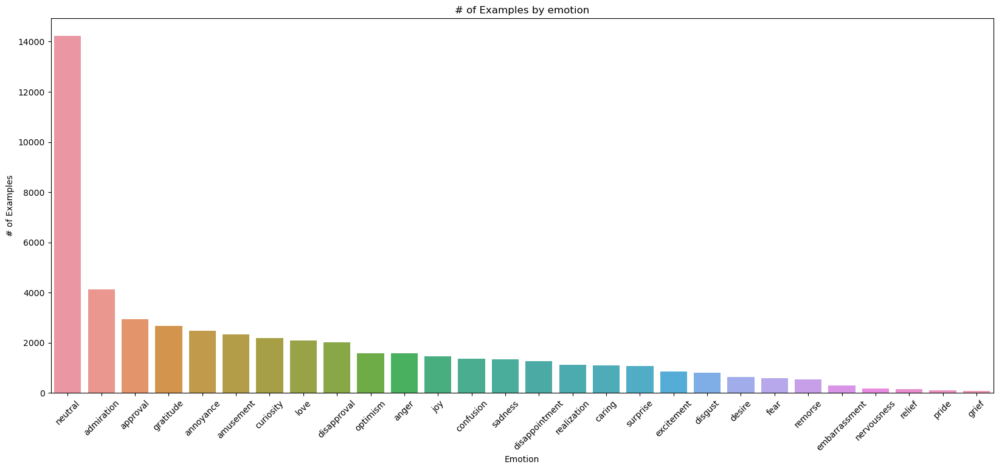

In [157]:
plt.figure(figsize = (20,8))
sns.barplot(data = num_cols_sum, x = 'emotion',y ='examples')
plt.xticks(rotation=45)
plt.title('# of Examples by emotion')
plt.ylabel('# of Examples')
plt.xlabel('Emotion')
plt.show()


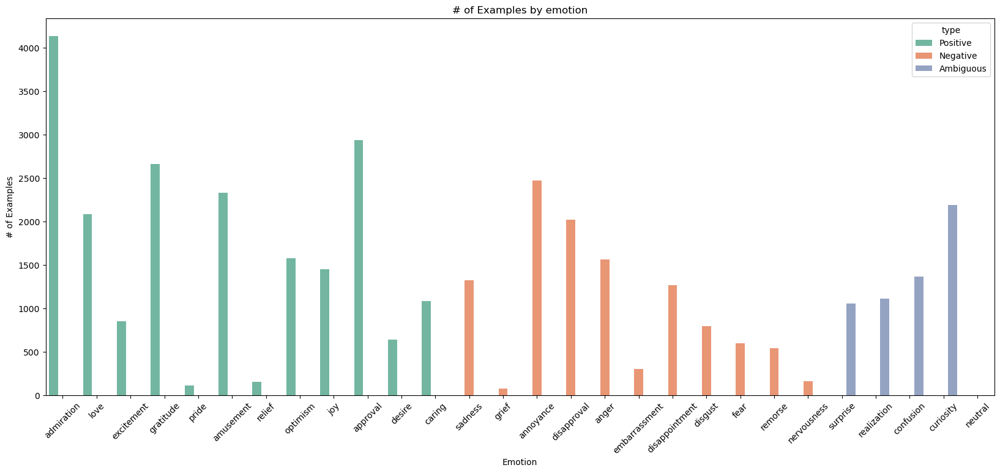

In [146]:
import seaborn as sns
plt.figure(figsize = (20,8))
sns.barplot(data = num_cols_sum.sort_values('type',ascending = False), x = 'emotion',y ='examples',hue = 'type',palette = 'Set2')
plt.xticks(rotation=45)
plt.title('# of Examples by emotion')
plt.ylabel('# of Examples')
plt.xlabel('Emotion')
plt.show()


In [76]:
type(num_cols_sum)

pandas.core.series.Series

In [79]:
num_cols_sum.values

array([14219,  4130,  2939,  2662,  2470,  2328,  2191,  2086,  2022,
        1581,  1567,  1452,  1368,  1326,  1269,  1110,  1087,  1060,
         853,   793,   641,   596,   545,   303,   164,   153,   111,
          77])